In [211]:

import tensorflow as tf
from tensorflow.keras import layers 
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import LearningRateScheduler
from tensorflow.keras.callbacks import EarlyStopping

from tensorflow.keras.regularizers import l2
from sklearn import datasets
import pandas as pd
import numpy as np
print(tf.__version__)

import matplotlib.pyplot as plt
%matplotlib inline

2.0.0


In [191]:
higgs=pd.read_csv('HIGGS.csv',sep=',',nrows=2.6E6,header=None,dtype=np.float16)
#higgs=pd.read_csv('HIGGS.csv',sep=',',header=None,dtype=np.float16)

In [192]:
higgs.head()

,0,1,2,3,4,5,6,7,8,9,...,19,20,21,22,23,24,25,26,27,28
0,1.0,0.869141,-0.635254,0.225708,0.327393,-0.689941,0.754395,-0.248535,-1.091797,0.000000,...,-0.010452,-0.045776,3.101562,1.353516,0.979492,0.978027,0.919922,0.721680,0.988770,0.876465
1,1.0,0.907715,0.329102,0.359375,1.498047,-0.312988,1.095703,-0.557617,-1.587891,2.173828,...,-1.138672,-0.000819,0.000000,0.302246,0.833008,0.985840,0.978027,0.779785,0.992188,0.798340
2,1.0,0.798828,1.470703,-1.635742,0.453857,0.425537,1.104492,1.282227,1.381836,0.000000,...,1.128906,0.900391,0.000000,0.909668,1.108398,0.985840,0.951172,0.803223,0.865723,0.780273
3,0.0,1.344727,-0.876465,0.936035,1.992188,0.882324,1.786133,-1.646484,-0.942383,0.000000,...,-0.678223,-1.360352,0.000000,0.946777,1.028320,0.998535,0.728516,0.869141,1.026367,0.958008
4,1.0,1.105469,0.321289,1.522461,0.882812,-1.205078,0.681641,-1.070312,-0.921875,0.000000,...,-0.373535,0.113037,0.000000,0.755859,1.361328,0.986816,0.837891,1.132812,0.872070,0.808594


In [193]:
higgs.columns=['class_label','lepton_pT','lepton_eta','lepton_phi','missing_energy_magnitude','missing_energy_phi','jet_1_pt','jet_1_eta','jet_1_phi','jet_1_b_tag','jet_2_pt','jet_2_eta','jet_2_phi','jet_2_b_tag','jet_3_pt','jet_3_eta','jet_3_phi','jet_3_b_tag','jet_4_pt','jet_4_eta','jet_4_phi','jet_4_b_tag','m_jj','m_jjj','m_lv','m_jlv','m_bb','m_wbb','m_wwbb']

In [194]:
higgs.head()

,class_label,lepton_pT,lepton_eta,lepton_phi,missing_energy_magnitude,missing_energy_phi,jet_1_pt,jet_1_eta,jet_1_phi,jet_1_b_tag,...,jet_4_eta,jet_4_phi,jet_4_b_tag,m_jj,m_jjj,m_lv,m_jlv,m_bb,m_wbb,m_wwbb
0,1.0,0.869141,-0.635254,0.225708,0.327393,-0.689941,0.754395,-0.248535,-1.091797,0.000000,...,-0.010452,-0.045776,3.101562,1.353516,0.979492,0.978027,0.919922,0.721680,0.988770,0.876465
1,1.0,0.907715,0.329102,0.359375,1.498047,-0.312988,1.095703,-0.557617,-1.587891,2.173828,...,-1.138672,-0.000819,0.000000,0.302246,0.833008,0.985840,0.978027,0.779785,0.992188,0.798340
2,1.0,0.798828,1.470703,-1.635742,0.453857,0.425537,1.104492,1.282227,1.381836,0.000000,...,1.128906,0.900391,0.000000,0.909668,1.108398,0.985840,0.951172,0.803223,0.865723,0.780273
3,0.0,1.344727,-0.876465,0.936035,1.992188,0.882324,1.786133,-1.646484,-0.942383,0.000000,...,-0.678223,-1.360352,0.000000,0.946777,1.028320,0.998535,0.728516,0.869141,1.026367,0.958008
4,1.0,1.105469,0.321289,1.522461,0.882812,-1.205078,0.681641,-1.070312,-0.921875,0.000000,...,-0.373535,0.113037,0.000000,0.755859,1.361328,0.986816,0.837891,1.132812,0.872070,0.808594


In [195]:
higgs.describe()

,class_label,lepton_pT,lepton_eta,lepton_phi,missing_energy_magnitude,missing_energy_phi,jet_1_pt,jet_1_eta,jet_1_phi,jet_1_b_tag,...,jet_4_eta,jet_4_phi,jet_4_b_tag,m_jj,m_jjj,m_lv,m_jlv,m_bb,m_wbb,m_wwbb
count,2600000.0,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,...,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06,2.600000e+06
mean,NaN,NaN,2.949238e-04,-2.180338e-04,NaN,-8.206367e-04,NaN,-8.282661e-04,2.679825e-04,NaN,...,-2.304316e-04,-2.691746e-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
min,0.0,2.746582e-01,-2.435547e+00,-1.742188e+00,6.260872e-04,-1.744141e+00,1.378174e-01,-2.968750e+00,-1.741211e+00,0.000000e+00,...,-2.498047e+00,-1.743164e+00,0.000000e+00,9.118652e-02,1.987305e-01,8.306885e-02,1.574707e-01,4.812622e-02,3.034668e-01,3.308105e-01
25%,0.0,5.903320e-01,-7.382812e-01,-8.720703e-01,5.766602e-01,-8.715820e-01,6.791992e-01,-6.884766e-01,-8.676758e-01,0.000000e+00,...,-7.143555e-01,-8.720703e-01,0.000000e+00,7.910156e-01,8.461914e-01,9.858398e-01,7.675781e-01,6.738281e-01,8.193359e-01,7.705078e-01
50%,1.0,8.530273e-01,9.198189e-04,4.165173e-04,8.916016e-01,-1.540661e-03,8.945312e-01,-2.006531e-03,5.811453e-05,1.086914e+00,...,3.721714e-04,-1.374245e-03,0.000000e+00,8.950195e-01,9.506836e-01,9.897461e-01,9.165039e-01,8.735352e-01,9.472656e-01,8.720703e-01
75%,1.0,1.236328e+00,7.382812e-01,8.706055e-01,1.292969e+00,8.706055e-01,1.170898e+00,6.860352e-01,8.686523e-01,2.173828e+00,...,7.138672e-01,8.710938e-01,3.101562e+00,1.024414e+00,1.083008e+00,1.020508e+00,1.142578e+00,1.138672e+00,1.140625e+00,1.059570e+00
max,1.0,9.687500e+00,2.435547e+00,1.743164e+00,1.539844e+01,1.743164e+00,8.851562e+00,2.968750e+00,1.741211e+00,2.173828e+00,...,2.498047e+00,1.743164e+00,3.101562e+00,3.107812e+01,1.564062e+01,7.992188e+00,1.140625e+01,1.373438e+01,8.781250e+00,6.968750e+00


In [196]:
higgs.isnull().sum()

class_label                 0
lepton_pT                   0
lepton_eta                  0
lepton_phi                  0
missing_energy_magnitude    0
missing_energy_phi          0
jet_1_pt                    0
jet_1_eta                   0
jet_1_phi                   0
jet_1_b_tag                 0
jet_2_pt                    0
jet_2_eta                   0
jet_2_phi                   0
jet_2_b_tag                 0
jet_3_pt                    0
jet_3_eta                   0
jet_3_phi                   0
jet_3_b_tag                 0
jet_4_pt                    0
jet_4_eta                   0
jet_4_phi                   0
jet_4_b_tag                 0
m_jj                        0
m_jjj                       0
m_lv                        0
m_jlv                       0
m_bb                        0
m_wbb                       0
m_wwbb                      0
dtype: int64

In [197]:
x=higgs.copy()
x=x.drop(['class_label'],axis=1)
x.head()

,lepton_pT,lepton_eta,lepton_phi,missing_energy_magnitude,missing_energy_phi,jet_1_pt,jet_1_eta,jet_1_phi,jet_1_b_tag,jet_2_pt,...,jet_4_eta,jet_4_phi,jet_4_b_tag,m_jj,m_jjj,m_lv,m_jlv,m_bb,m_wbb,m_wwbb
0,0.869141,-0.635254,0.225708,0.327393,-0.689941,0.754395,-0.248535,-1.091797,0.000000,1.375000,...,-0.010452,-0.045776,3.101562,1.353516,0.979492,0.978027,0.919922,0.721680,0.988770,0.876465
1,0.907715,0.329102,0.359375,1.498047,-0.312988,1.095703,-0.557617,-1.587891,2.173828,0.812500,...,-1.138672,-0.000819,0.000000,0.302246,0.833008,0.985840,0.978027,0.779785,0.992188,0.798340
2,0.798828,1.470703,-1.635742,0.453857,0.425537,1.104492,1.282227,1.381836,0.000000,0.851562,...,1.128906,0.900391,0.000000,0.909668,1.108398,0.985840,0.951172,0.803223,0.865723,0.780273
3,1.344727,-0.876465,0.936035,1.992188,0.882324,1.786133,-1.646484,-0.942383,0.000000,2.423828,...,-0.678223,-1.360352,0.000000,0.946777,1.028320,0.998535,0.728516,0.869141,1.026367,0.958008
4,1.105469,0.321289,1.522461,0.882812,-1.205078,0.681641,-1.070312,-0.921875,0.000000,0.800781,...,-0.373535,0.113037,0.000000,0.755859,1.361328,0.986816,0.837891,1.132812,0.872070,0.808594


In [198]:
y=higgs['class_label']
y.head()

0    1.0
1    1.0
2    1.0
3    0.0
4    1.0
Name: class_label, dtype: float16

### Scale Data

In [199]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0, 1))
scaled_train = scaler.fit_transform(x)

# Print out the adjustment that the scaler applied to the total_earnings column of data
print("Note: median values were scaled by multiplying by {:.10f} and adding {:.6f}".format(scaler.scale_[12], scaler.min_[12]))
multiplied_by = scaler.scale_[12]
added = scaler.min_[12]

scaled_train_df = pd.DataFrame(scaled_train, columns=x.columns.values)

Note: median values were scaled by multiplying by 0.4514991182 and adding 0.000000


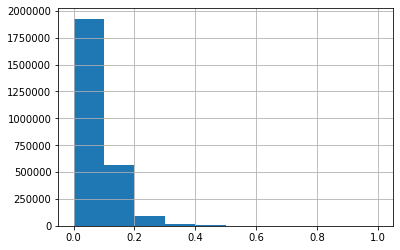

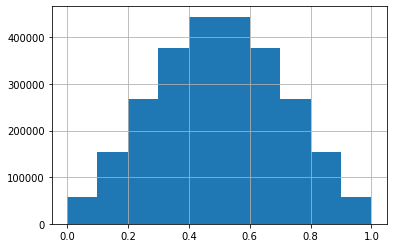

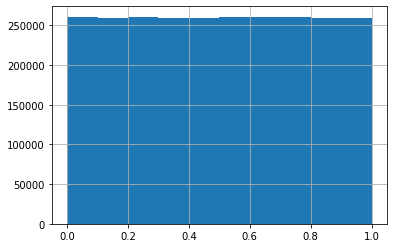

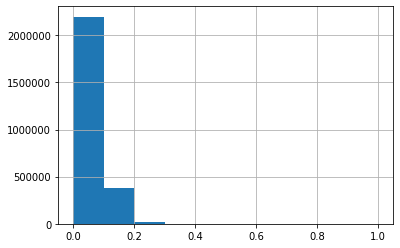

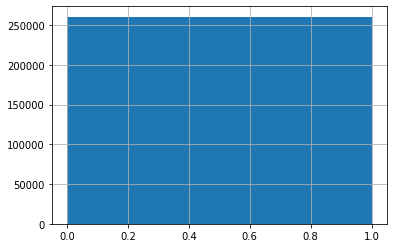

...

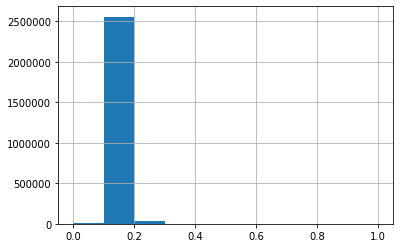

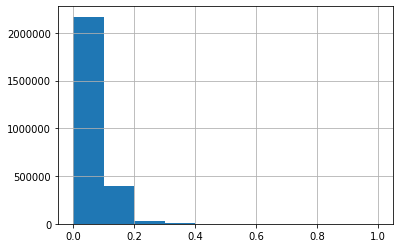

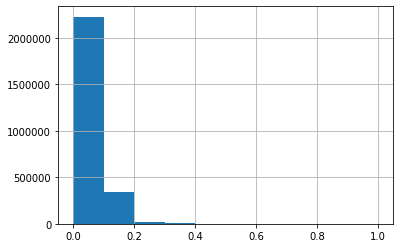

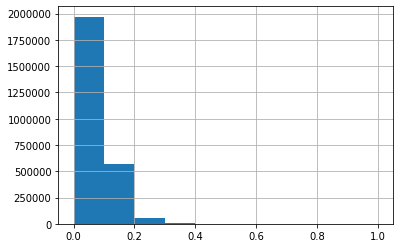

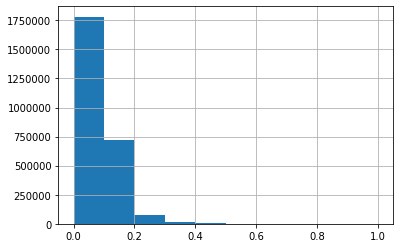

In [200]:
for i in scaled_train_df:
    scaled_train_df[i].hist()
    plt.show()

### Model

In [201]:
x.shape

(2600000, 28)

In [202]:
model = tf.keras.Sequential()
model.add(layers.Dense(300, activation='tanh'))
model.add(layers.Dense(300, activation='tanh'))
model.add(layers.Dense(300, activation='tanh'))
model.add(layers.Dense(300, activation='tanh'))
model.add(layers.Dense(1,activation='tanh'))

### Compile Model

In [203]:


learning_rate=0.05
decay_rate=1E-5
sgd = SGD(lr=learning_rate,  decay=decay_rate, nesterov=False)
model.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])

#model.compile(optimizer='sgd',loss='mean_squared_error',metrics=['mean_squared_error'])

### Fit Model

In [204]:
print(type(x))
print(type(y))

y= np.asarray(y)
print(type(y))

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>
<class 'numpy.ndarray'>


In [205]:
model.fit(scaled_train_df.values, y, epochs=5, batch_size=32)

Train on 2600000 samples
Epoch 1/5
2600000/2600000 [==============================] - 162s 62us/sample - loss: 6.2661 - accuracy: 0.4960
Epoch 2/5
2600000/2600000 [==============================] - 157s 61us/sample - loss: 8.1692 - accuracy: 0.4704
Epoch 3/5
2600000/2600000 [==============================] - 159s 61us/sample - loss: 8.1692 - accuracy: 0.4704
Epoch 4/5
2600000/2600000 [==============================] - 156s 60us/sample - loss: 8.1692 - accuracy: 0.4704
Epoch 5/5
2600000/2600000 [==============================] - 169s 65us/sample - loss: 8.1692 - accuracy: 0.4704


In [179]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(scaled_train_df, y, test_size=0.38, random_state=1776)

In [180]:
print(x_test.shape)
print(type(np.asarray(y_test)).shape)

(1368000, 28)
<attribute 'shape' of 'numpy.ndarray' objects>


In [181]:
# Evaluate the model on the test data using `evaluate`
print('\n# Evaluate on test data')
results = model.evaluate(np.asarray(x_test), np.asarray(y_test), batch_size=128)
print('test loss, test acc:', results)


# Evaluate on test data
1368000/1 [====================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================

test loss, test acc: [7.2054673857214855, 0.5300753]


In [206]:
# Generate predictions (probabilities -- the output of the last layer)
# on new data using `predict`
#print('\n# Generate predictions for 3 samples')
predictions = model.predict(np.asarray(x))
print('predictions shape:', predictions.shape)

predictions shape: (2600000, 1)


In [207]:
from sklearn import metrics

fpr_keras, tpr_keras, thresholds_keras = metrics.roc_curve(y,predictions,pos_label=None)

In [208]:
from sklearn.metrics import auc
auc_keras = auc(fpr_keras, tpr_keras)

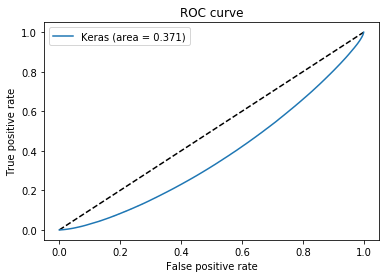

In [209]:
plt.figure(1)
plt.plot([0, 1], 'k--')
plt.plot(fpr_keras, tpr_keras, label='Keras (area = {:.3f})'.format(auc_keras))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best')
plt.show()


In [210]:
print(auc_keras)

0.37085807942692517


### Hyperparameters

hidden layers - tanh function  

initial weights - normal distribution with zero mean and std = 0.1 in first layer , 0.001 in the output layer and 0.05 in all other hidden layers

gradient computations on batch of size = 100


momentum - increased linearly over first 200 epochs from 0.9 to 0.99 , after which it is constant  

learning rate decayed by a factor of 1.0000002 every batch update until it reached a minimum of 10 power -6

Training ended when momentum reached maximum value and min error on validation set had not decreased by more than a factor of 0.00001 over 10 epochs



In [240]:
o_w1=model.layers[1].get_weights()
print(o_w1[0].shape)
print(o_w1[1].shape)

(300, 300)
(300,)


In [229]:
type(np.random.normal(0, 0.1, 300))

numpy.ndarray

In [235]:

w1= [np.random.normal(0, 0.1, 300),np.asarray([0]*300)]
model.layers[1].set_weights(w1)
#print(type(w1))

ValueError: Layer weight shape (300, 300) not compatible with provided weight shape (300,)

In [215]:
w1= [np.random.normal(0, 0.1, 300),[0]*300]
model.layers[1].set_weights(w1)
w2= np.random.normal(0, 0.05, 300)
model.layers[2].set_weights(w2)
w3= np.random.normal(0, 0.05, 300)
model.layers[3].set_weights(w3)
w4= np.random.normal(0, 0.05, 300)
model.layers[4].set_weights(w4)
w5= np.random.normal(0, 0.001, 1)
model.layers[5].set_weights(w5)

ValueError: You called `set_weights(weights)` on layer "dense_41" with a  weight list of length 300, but the layer was expecting 2 weights. Provided weights: [-8.30546807e-02  1.04835887e-01  6.07569488e-02  ...

In [212]:
def step_decay(epoch):
    initial_lrate = 0.05
    lrate=initial_lrate/((1+epoch)*1.0000002)
    if lrate>=10E-6:
        return lrate
    else:
        return None


In [213]:
# learning schedule callback
lrate = LearningRateScheduler(step_decay)
earlystopper= EarlyStopping(monitor='val_loss',min_delta=0.00001,patience=10)
callbacks_list = [lrate,earlystopper]
# Fit the model
model.fit(scaled_train_df.values, y, validation_split=0.3, epochs=40, batch_size=100, callbacks=callbacks_list, verbose=2)

Train on 1820000 samples, validate on 780000 samples


AttributeError: 'list' object has no attribute 'set_model'

In [188]:
def get_momentum(epoch):
    return min(epoch*(0.09/200),0.09)

In [189]:
predictions2 = model.predict(np.asarray(x))
fpr_keras2, tpr_keras2, thresholds_keras2 = metrics.roc_curve(y,predictions2,pos_label=None)
auc_keras2 = auc(fpr_keras2, tpr_keras2)

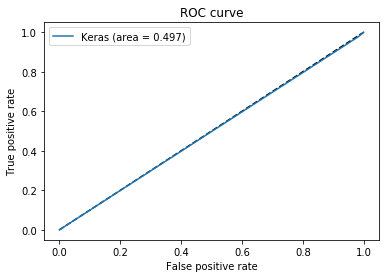

In [190]:
plt.figure(1)
plt.plot([0, 1], 'k--')
plt.plot(fpr_keras2, tpr_keras2, label='Keras (area = {:.3f})'.format(auc_keras2))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best')
plt.show()

In [ ]:
sgd = SGD(lr=learning_rate,  decay=decay_rate,nesterov=False)
model.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])

In [243]:
model2 = tf.keras.Sequential()
model2.add(layers.Dense(300, activation='tanh',kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.1, seed=None)))
model2.add(layers.Dense(300, activation='tanh',kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=None)))
model2.add(layers.Dense(300, activation='tanh',kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=None)))
model2.add(layers.Dense(300, activation='tanh',kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=None)))
model2.add(layers.Dense(1,activation='tanh',kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.001, seed=None)))

In [244]:
learning_rate=0.05
decay_rate=1E-5
sgd = SGD(lr=learning_rate,  decay=decay_rate, momentum=0.09,nesterov=False)
model2.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])

In [ ]:
model2.fit(scaled_train_df.values, y, epochs=5, batch_size=32)

Train on 2600000 samples
Epoch 1/5
1553952/2600000 [================>.............] - ETA: 1:20 - loss: 7.2157 - accuracy: 0.5294

In [ ]:
# learning schedule callback
lrate = LearningRateScheduler(step_decay)
earlystopper= EarlyStopping(monitor='val_loss',min_delta=0.00001,patience=10)
callbacks_list = [lrate,earlystopper]
# Fit the model
model2.fit(scaled_train_df.values, y, validation_split=0.3, epochs=40, batch_size=100, callbacks=callbacks_list, verbose=2)

In [ ]:
predictions2 = model2.predict(np.asarray(scaled_train_df.values))
fpr_keras2, tpr_keras2, thresholds_keras2 = metrics.roc_curve(y,predictions2,pos_label=None)
auc_keras2 = auc(fpr_keras2, tpr_keras2)
print(auc_keras2)

In [ ]:
plt.figure(1)
plt.plot([0, 1], 'k--')
plt.plot(fpr_keras2, tpr_keras2, label='Keras (area = {:.3f})'.format(auc_keras2))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best')
plt.show()